# County Level Choropleth Map

In [1]:
import requests
import pandas as pd
import numpy as np

import plotly as py
import plotly.express as px
import plotly.graph_objects as go
import json

from urllib.request import urlopen

## Import from the New York Times' github

In [2]:
us_covid = pd.read_csv('../datasets/covid-19-data/us-counties.csv',
                      dtype={"fips":str})
us_covid.head()

,date,county,state,fips,cases,deaths
0,2020-01-21,Snohomish,Washington,53061,1,0
1,2020-01-22,Snohomish,Washington,53061,1,0
2,2020-01-23,Snohomish,Washington,53061,1,0
3,2020-01-24,Cook,Illinois,17031,1,0
4,2020-01-24,Snohomish,Washington,53061,1,0


## Grab date, fips, cases and turn to a pivot table

In [3]:
covid_fips_cases_ = us_covid[['date', 'fips', 'cases']].copy()
covid_fips_cases_.dropna(inplace=True)
covid_fips_cases = covid_fips_cases_.pivot(index='fips', 
                                           columns='date', values='cases')
covid_fips_cases.fillna(0, inplace=True)
covid_fips_cases.columns = pd.to_datetime(covid_fips_cases.columns)

In [4]:
covid_fips_cases.head()

date,2020-01-21,2020-01-22,2020-01-23,2020-01-24,2020-01-25,2020-01-26,2020-01-27,2020-01-28,2020-01-29,2020-01-30,...,2020-03-31,2020-04-01,2020-04-02,2020-04-03,2020-04-04,2020-04-05,2020-04-06,2020-04-07,2020-04-08,2020-04-09
fips,,,,,,,,,,,,,,,,,,,,,
01001,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,7.0,10.0,10.0,12.0,12.0,12.0,12.0,12.0,12.0,17.0
01003,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,19.0,23.0,25.0,28.0,29.0,34.0,38.0,42.0,49.0,59.0
01005,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,1.0,2.0,2.0,3.0,3.0,3.0,7.0
01007,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,3.0,3.0,4.0,4.0,4.0,7.0,7.0,8.0,9.0,11.0
01009,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,5.0,5.0,6.0,9.0,10.0,10.0,10.0,10.0,10.0,11.0


## Grab fips, county, state

In [5]:
fips_county_cases = us_covid[['fips', 'county']].copy()
fips_county_cases.drop_duplicates(subset='fips', keep='first', inplace=True)

In [6]:
fips_county_cases.head()

,fips,county
0,53061,Snohomish
3,17031,Cook
5,06059,Orange
8,04013,Maricopa
9,06037,Los Angeles


## 3-Day Percent Increase 

In [7]:
positive_cases = covid_fips_cases.copy()
positive_cases['3 day'] = ((positive_cases.iloc[:, -1] - positive_cases.iloc[:, -4]) / 
            positive_cases.iloc[:, -4]) * 100
positive_cases['Prev 3 day'] = ((positive_cases.iloc[:, -5] - positive_cases.iloc[:, -8]) / 
            positive_cases.iloc[:, -8]) * 100

In [8]:
positive_cases.head()

date,2020-01-21 00:00:00,2020-01-22 00:00:00,2020-01-23 00:00:00,2020-01-24 00:00:00,2020-01-25 00:00:00,2020-01-26 00:00:00,2020-01-27 00:00:00,2020-01-28 00:00:00,2020-01-29 00:00:00,2020-01-30 00:00:00,...,2020-04-02 00:00:00,2020-04-03 00:00:00,2020-04-04 00:00:00,2020-04-05 00:00:00,2020-04-06 00:00:00,2020-04-07 00:00:00,2020-04-08 00:00:00,2020-04-09 00:00:00,3 day,Prev 3 day
fips,,,,,,,,,,,,,,,,,,,,,
01001,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,10.0,12.0,12.0,12.0,12.0,12.0,12.0,17.0,41.666667,0.000000
01003,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,25.0,28.0,29.0,34.0,38.0,42.0,49.0,59.0,55.263158,35.714286
01005,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,1.0,2.0,2.0,3.0,3.0,3.0,7.0,133.333333,200.000000
01007,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,4.0,4.0,4.0,7.0,7.0,8.0,9.0,11.0,57.142857,75.000000
01009,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,6.0,9.0,10.0,10.0,10.0,10.0,10.0,11.0,10.000000,11.111111


In [9]:
three_days = positive_cases[['3 day', 'Prev 3 day']].copy()
three_days.head()

date,3 day,Prev 3 day
fips,,
01001,41.666667,0.000000
01003,55.263158,35.714286
01005,133.333333,200.000000
01007,57.142857,75.000000
01009,10.000000,11.111111


### Reset index

In [10]:
three_days.reset_index(inplace=True)
three_days.head()

date,fips,3 day,Prev 3 day
0,01001,41.666667,0.000000
1,01003,55.263158,35.714286
2,01005,133.333333,200.000000
3,01007,57.142857,75.000000
4,01009,10.000000,11.111111


### Clean data

In [11]:
three_days.fillna(0, inplace=True)
three_days.replace(np.inf, 0, inplace=True)
three_days.head()

date,fips,3 day,Prev 3 day
0,01001,41.666667,0.000000
1,01003,55.263158,35.714286
2,01005,133.333333,200.000000
3,01007,57.142857,75.000000
4,01009,10.000000,11.111111


In [12]:
df = three_days[['fips', '3 day', 'Prev 3 day']].copy()
df.head()

date,fips,3 day,Prev 3 day
0,01001,41.666667,0.000000
1,01003,55.263158,35.714286
2,01005,133.333333,200.000000
3,01007,57.142857,75.000000
4,01009,10.000000,11.111111


## Merge the fips with county

In [13]:
df = pd.merge(fips_county_cases, df, on='fips')

In [14]:
max_3_day = df['3 day'].max()
max_3_day

700.0

In [15]:
df['3 day'].median()

22.22222222222222

### Round the percent changes to 2 decimal places

In [16]:
df['3 day'] = (df['3 day'].round(2))
df['Prev 3 day'] = (df['Prev 3 day'].round(2))

In [17]:
df.head()

,fips,county,3 day,Prev 3 day
0,53061,Snohomish,6.18,10.56
1,17031,Cook,30.79,34.84
2,06059,Orange,22.34,24.05
3,04013,Maricopa,17.86,36.61
4,06037,Los Angeles,25.08,39.29


## Drop counties with '0' change, make the plot easier to read

In [18]:
df = df.replace(0, np.nan)
df = df.dropna(how='all', axis=0)

### Load county fips info

In [19]:
with urlopen('https://raw.githubusercontent.com/plotly/datasets/master/geojson-counties-fips.json') as response:
    counties = json.load(response)

## Map onto choropleth map

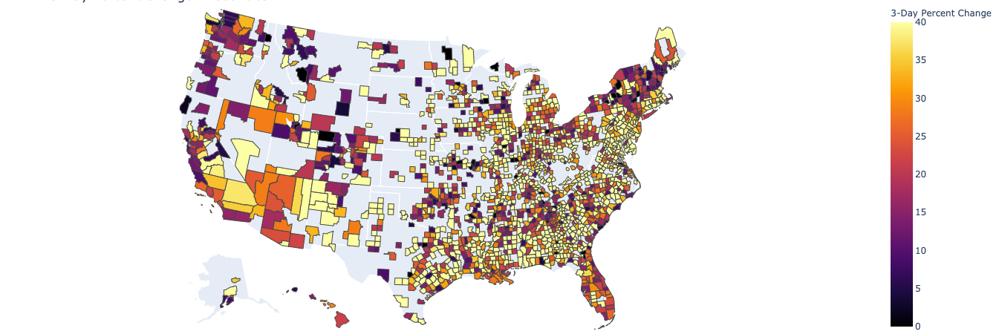

In [20]:
fig = px.choropleth(df, geojson=counties, locations='fips', color='3 day',
                           color_continuous_scale=px.colors.sequential.Inferno,
                           range_color=(0, 40),
                           scope="usa",
                           labels={'3 day':'3-Day Percent Change'},
                           title='3-Day Percent Change in Counties',
                           hover_data=[df['county'], df['Prev 3 day']]
                          )

fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
#fig.write_html('county.html')
fig.show()

# Investigate changes in 3-day

### Subtract prev 3-day from current 3-day to get the changes. If the value is postive, that means the county is trending in the wrong direction (i.e., social distancing is not working). If negative, trending in correct direction (i.e., social distancing is working)

In [21]:
df['Change in 3-Day'] = df['3 day'] - df['Prev 3 day']

In [22]:
df.head()

,fips,county,3 day,Prev 3 day,Change in 3-Day
0,53061,Snohomish,6.18,10.56,-4.38
1,17031,Cook,30.79,34.84,-4.05
2,06059,Orange,22.34,24.05,-1.71
3,04013,Maricopa,17.86,36.61,-18.75
4,06037,Los Angeles,25.08,39.29,-14.21


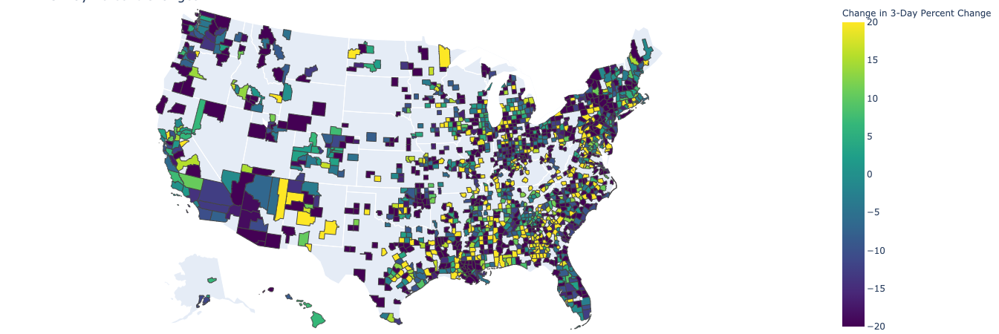

In [23]:
fig = px.choropleth(df, geojson=counties, locations='fips', color='Change in 3-Day',
                           color_continuous_scale=px.colors.sequential.Viridis,
                           range_color=(-20, 20),
                           scope="usa",
                           labels={'Change in 3-Day':'Change in 3-Day Percent Change'},
                           title='3-Day Percent Changes',
                           hover_data=[df['county'], df['3 day'], df['Prev 3 day']]
                          )

fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.write_html('county_difference.html')
fig.show();